# Toomre's criterion for a Kuzmin disc (1)

## Imports

In [1]:
import numpy as np
import scipy
import math
import random
import pandas as pd
from matplotlib import animation
from matplotlib.animation import FuncAnimation
from scipy import interpolate
import matplotlib.pyplot as plt
import os
import time
import seaborn as sns
%matplotlib inline
%config InlineBackend.figure_format='retina'

rc_params = {'backend': 'ps',
            'font.family': 'Times New Roman',
            'font.sans-serif': ['Bitstream Vera Sans'],
            'axes.unicode_minus':False,
            'text.usetex':True,
            'axes.grid':True,
            'grid.linestyle':'-',
            'grid.linewidth':0.5,
            'hist.bins':50,
            'axes.labelsize':14,
            'axes.titlesize':14,
            'xtick.labelsize':10,
            'ytick.labelsize':10,
            'legend.fontsize':10,
            'savefig.bbox':'tight',
            'savefig.transparent':False,
            'figure.dpi':100}
plt.rcParams.update(rc_params)

In [2]:
def dati (data,N):

    step = N*3+3
    
    t = np.array([data.iloc[2::step,0].copy().dropna()]).flatten()
    m = np.array([data.iloc[i::step,0].copy().dropna() for i in range(3, N+3)])
    x = np.array([data.iloc[i::step,0].copy().dropna() for i in range(N+3, 2*N+3)])
    y = np.array([data.iloc[i::step,1].copy().dropna() for i in range(N+3, 2*N+3)])
    z = np.array([data.iloc[i::step,2].copy().dropna() for i in range(N+3, 2*N+3)])
    vx = np.array([data.iloc[i::step,0].copy().dropna() for i in range(2*N+3, 3*N+3)])
    vy = np.array([data.iloc[i::step,1].copy().dropna() for i in range(2*N+3, 3*N+3)])
    vz = np.array([data.iloc[i::step,2].copy().dropna() for i in range(2*N+3, 3*N+3)])

    r = np.array([(x[i]**2+y[i]**2+z[i]**2)**0.5 for i in range(N)])
        
    return x,y,z,r,t

def find_nearest(array, value):
    array = np.asarray(array)
    idx   = (np.abs(array-value)).argmin()
    return idx

# Analytic formulas

In [3]:
a = 10
G = 1
M_tot = 10
beta = 0.1

In [4]:
Sigma_R = lambda R : M_tot/(2*np.pi) * a /((R**2+a**2)**(3/2))
M_R = lambda R : M_tot*( 1 -(1 /( R**2/a**2 +1 )**(1/2)))
R_M = lambda M : ( ( 1 / (1-(M/M_tot))**2 ) - 1 )**(1/2) * a
theta_punto_R = lambda R : (G*M_tot/(R**2 + a**2)**(3/2))**(1/2)
k_R = lambda R : (G*M_tot*(-(3*R**2)/(R**2 + a**2)**(5/2) + 4/(R**2 + a**2)**(3/2)))**(1/2)
sigma_R = lambda R : beta*R*theta_punto_R(R)
Q_R = lambda R : sigma_R(R)*k_R(R)/(3.36*G*Sigma_R(R))
R_grid = np.geomspace(1e-3, 1e6, 10000)
R_Q = interpolate.interp1d(Q_R(R_grid),R_grid)


$$ \text{Plummer-Kuzmin distribution} $$

$$\text{Potential:} \quad \Phi (R,z=0) = - \frac{GM}{\sqrt{R^2 +a^2}} \qquad \text{Density distribution:} \quad \Sigma(R)=\frac{M}{2\pi}\frac{a}{(R^2+a^2)^{3/2}} $$

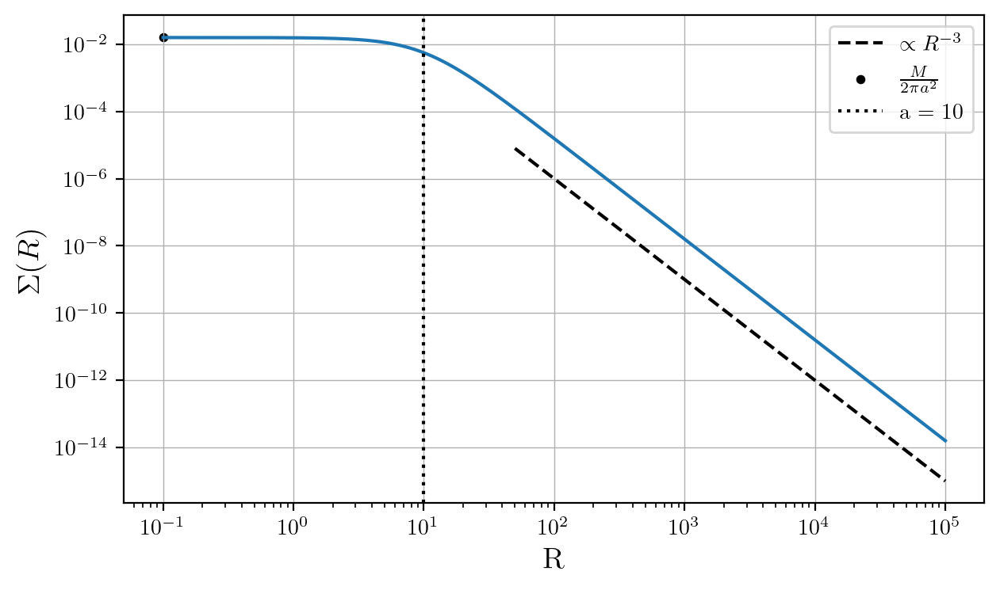

In [5]:
Rgrid = np.geomspace(1e-1,1e5, 5000)
Rgrid_ext = np.geomspace(5*a,Rgrid[-1],1000)
Rgrid_int = np.geomspace(Rgrid[0],a/2,1000)
Sigma_grid = Sigma_R(Rgrid)

fig,ax = plt.subplots(figsize=(7,4))
ax.plot(Rgrid,Sigma_grid)
ax.plot(Rgrid_ext,Rgrid_ext**(-3), ls='--', label='$\propto R^{-3}$', c='k')
ax.scatter(Rgrid[0],M_tot/(2*np.pi*a**2), c='k', s=10, label=r'$\frac{M}{2\pi a^2}$')
ax.axvline(a, ls=':', c='k', label='a = %i'%a)
ax.set_ylabel('$\Sigma(R)$')
ax.set_xlabel('R')
ax.legend()
plt.loglog()
#plt.savefig('Sigma_analytic.png', dpi=500)
plt.show()

$$ \text{Circular orbits:} \quad R\dot{\theta}^2 =  \nabla \Phi \qquad \text{Circular velocity:} \quad \dot{\theta}^2 = \frac{GM}{(R^2 +a^2)^{\frac{3}{2}}}$$

$$k^2=\frac{\partial\Phi_{eff}}{\partial R^2}\Big|_{0} = R \frac{\partial \dot{\theta}^2}{\partial R} + 4 \dot{\theta}^2 = - \frac{3GMR^2}{(R^2 +a^2)^{\frac{5}{2}}} + 4\dot{\theta}^2 = GM \left( - \frac{3R^2}{(R^2 +a^2)^{\frac{5}{2}}} + \frac{4}{(R^2 +a^2)^{\frac{3}{2}}} \right)$$

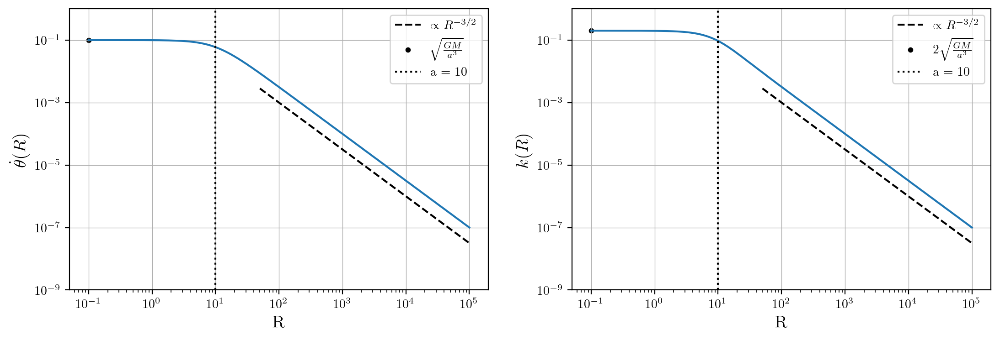

In [6]:
theta_punto_grid = theta_punto_R(Rgrid)
k_grid = k_R(Rgrid)

fig,(ax1,ax2) = plt.subplots(1,2, figsize=(13,4))

ax1.plot(Rgrid,theta_punto_grid)
ax1.plot(Rgrid_ext,Rgrid_ext**(-3/2), ls='--', label='$\propto R^{-3/2}$', c='k')
ax1.scatter(Rgrid[0],(G*M_tot/(a**3))**(1/2), c='k', s=10, label=r'$\sqrt{\frac{GM}{a^3}}$')
ax1.axvline(a, ls=':', c='k', label='a = %i'%a)
ax1.set_ylabel(r'$\dot{\theta} (R)$')
ax1.set_xlabel('R')
ax1.legend()
ax1.set_ylim(1e-9,1)
ax1.loglog()

ax2.plot(Rgrid,k_grid)
ax2.plot(Rgrid_ext,Rgrid_ext**(-3/2), ls='--', label='$\propto R^{-3/2}$', c='k')
ax2.scatter(Rgrid[0],2*(G*M_tot/(a**3))**(1/2), c='k', s=10, label=r'$2\sqrt{\frac{GM}{a^3}}$')
ax2.axvline(a, ls=':', c='k', label='a = %i'%a)
ax2.set_ylabel(r'$k(R)$')
ax2.set_xlabel('R')
ax2.set_ylim(1e-9,1)
ax2.legend()
ax2.loglog()
#plt.savefig('frequency_analytic.png', dpi=500)
plt.show()

$$ \text{Toomre parameter:} \quad Q=\frac{\sigma k}{3.36 G \Sigma}$$

$$ \frac{Q}{\sigma_R} = \frac{k}{3.36 G \Sigma}$$

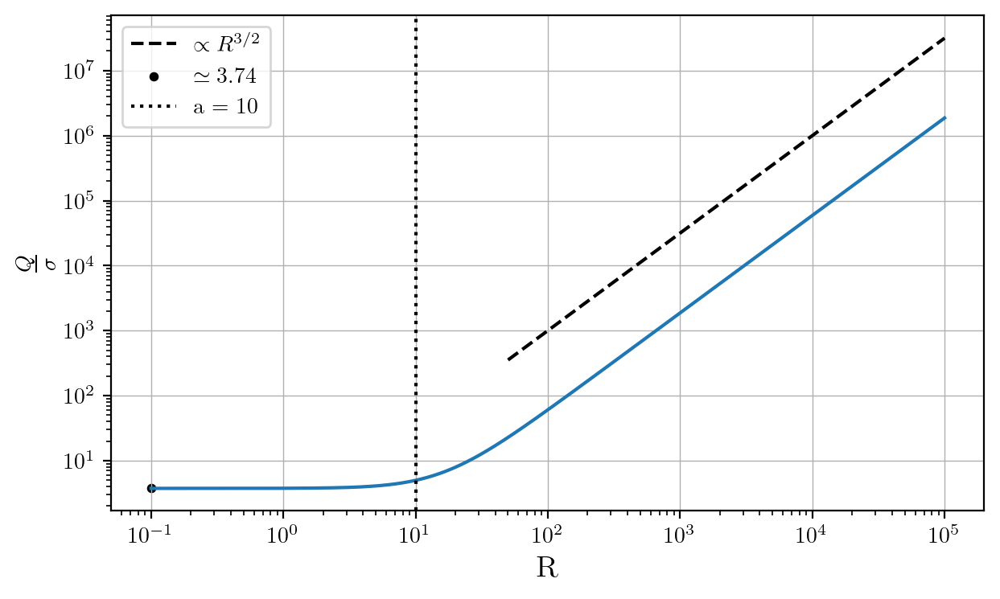

In [7]:
fig, ax = plt.subplots(1,1, figsize=(7,4))

ax.plot(Rgrid, k_grid/(3.36*G*Sigma_grid))
ax.plot(Rgrid_ext,Rgrid_ext**(3/2), ls='--', label='$\propto R^{3/2}$', c='k')
ax.scatter(Rgrid[0],k_grid[0]/(3.36*G*Sigma_grid[0]), c='k', s=10, label=r'$\simeq %.2f$'%(k_grid[0]/(3.36*G*Sigma_grid[0])))
ax.axvline(a, ls=':', c='k', label= 'a = %i'%a)
ax.set_ylabel(r'$\frac{Q}{\sigma}$')
ax.set_xlabel('R')
ax.legend()
ax.loglog()
plt.show()

<span style="font-family: Times New Roman"> I choose the velocity dispersion to be a fraction ($\beta$ = 0.1) of the circular velocity. In this way the Toomre parameter Q increases with R. It reaches 1 at R=50. </span>
$$ Q = \frac{\sigma k}{3.36 G \Sigma} \qquad \text{with :} \qquad \sigma = \beta R \dot{\theta} $$

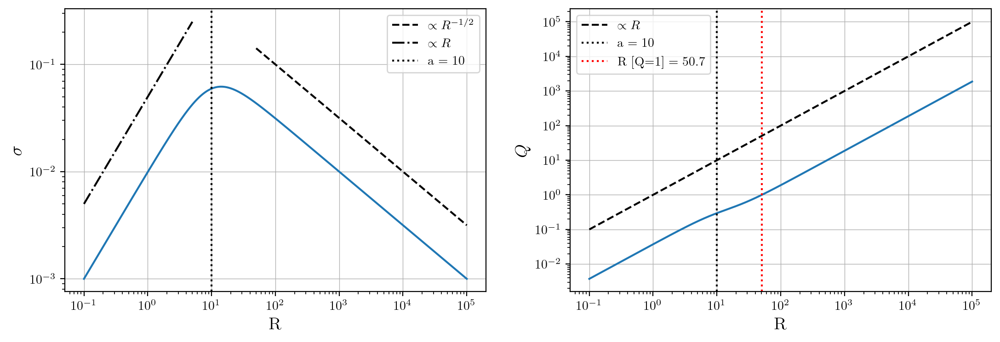

In [8]:
fig, (ax1,ax2) = plt.subplots(1,2, figsize=(13,4))

sigma_grid = sigma_R(Rgrid)

ax1.plot(Rgrid, sigma_grid)
ax1.plot(Rgrid_ext,Rgrid_ext**(-1/2), ls='--', label=r'$\propto R^{-1/2}$', c='k')
ax1.plot(Rgrid_int,Rgrid_int/20, ls='-.', label=r'$\propto R$', c='k')
ax1.axvline(a, ls=':', c='k', label='a = %i'%a)
ax1.set_ylabel(r'$\sigma$')
ax1.set_xlabel('R')
ax1.legend()
ax1.loglog()

Q_grid=Q_R(Rgrid)
ax2.plot(Rgrid, Q_grid)
ax2.plot(Rgrid,Rgrid, ls='--', label=r'$\propto R$', c='k')
ax2.axvline(a, ls=':', c='k', label='a = %i'%a)
ax2.axvline(R_Q(1), ls=':', c='r', label='R [Q=1] = %.1f'%R_Q(1))
ax2.set_ylabel(r'$Q$')
ax2.set_xlabel('R')
ax2.legend()
ax2.loglog()
#plt.savefig('Q_analytic.png', dpi=500)
plt.show()

## Initialization of the distribution

$$M_{shell}(R)=2\pi\int_{R_i}^{R} dR'R'\Sigma(R') = M\int_{R_i}^{R}dR'R'\frac{a}{(R'^2+a^2)^{3/2}}=\frac{1}{2}M\int_{\frac{R_i^2}{a^2}}^{\frac{R_e^2}{a^2}}\frac{1}{(1+y)^{3/2}}=-\frac{M}{(1+y)^{1/2}}\Big|_{\frac{R_i^2}{a^2}}^{\frac{R^2}{a^2}}=M\left[\frac{1}{(\frac{R_i^2}{a^2}+1)^{1/2}}-\frac{1}{(\frac{R^2}{a^2}+1)^{1/2}}\right]$$
$$\text{Radial coordinate:} \quad R = \left[\frac{1}{\left(\frac{1}{(\frac{R_i^2}{a^2}+1)^{1/2}}-\frac{M(R)}{M}\right)^2}-1\right]^{1/2}\cdot a \quad \text{with} \quad 0<\frac{M_{shell}(R)}{M}<\frac{M_{shell,tot}(R)}{M} \qquad ; \qquad \text{Angular coordinate:} \quad 0< \theta < 2\pi$$

In [9]:
Q_val = [1e-1,1,2,3,5,10]
R_shell = np.array([R_Q(q) for q in Q_val])
R_shell = np.insert(R_shell,0,0)
R_shell = np.append(R_shell, 1e5)

In [10]:
np.random.seed(1)
N_shell=[3000,20000,20000,20000,20000, 20000, 30000] #[1e-1,1,2,3,5,10]
col=plt.colormaps['Set2'](np.linspace(0,1,8))
idx_shell = np.arange(len(R_shell))
R=[]
theta=[]
M=[]
for i in idx_shell[:-1]:
    N=N_shell[i]
    M_shell_tot = M_R(R_shell[i+1])-M_R(R_shell[i])
    cdf   = np.random.uniform(0, M_shell_tot/M_tot, N) #cdf = M(R)/M_tot
    radius = ((1/(1/((R_shell[i]/a)**2 +1)**(1/2)-cdf)**2 -1)**(1/2))*a
    sort = np.argsort(radius)
    R = np.append(R,radius[sort])
    theta = np.append(theta, np.random.uniform(0,2*np.pi,N))
    M = np.append(M, np.ones(N)*M_shell_tot/N)
    
N = len(R)
print('Total number of particles = ', N)

Total number of particles =  133000


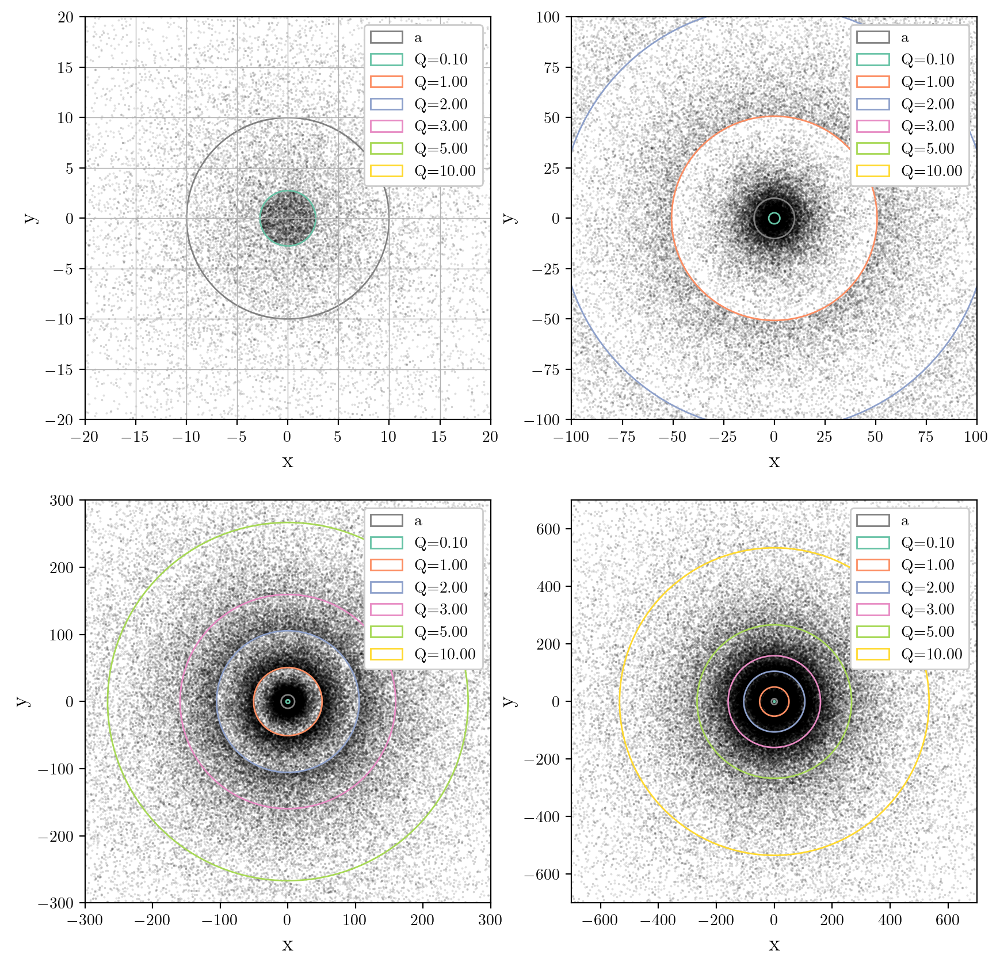

In [11]:
X = R*np.cos(theta)
Y = R*np.sin(theta)
Z = np.zeros(N)
fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(221)

ax.scatter(X[::],Y[::], color='k', s=0.1, alpha=0.2)
circle = plt.Circle((0, 0, 0), a, color='gray', fill=False, label='a')
ax.add_patch(circle)
for r,c in zip(R_shell[1:-1],col):
    circle_Q = plt.Circle((0, 0, 0), r,color=c, fill=False, label='Q=%.2f'%Q_R(r))
    ax.add_patch(circle_Q)
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_xlim(-20,20)
ax.set_ylim(-20,20)
plt.legend(framealpha=1, loc='upper right')

ax = fig.add_subplot(222)
ax.scatter(X[::],Y[::], color='k', s=0.1, alpha=0.2)
circle = plt.Circle((0, 0, 0), a, color='gray', fill=False, label='a')
ax.add_patch(circle)
for r,c in zip(R_shell[1:-1],col):
    circle_Q = plt.Circle((0, 0, 0), r,color=c, fill=False, label='Q=%.2f'%Q_R(r))
    ax.add_patch(circle_Q)
    ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_xlim(-100,100)
ax.set_ylim(-100,100)
ax.grid()
plt.legend(framealpha=1, loc='upper right')
#plt.show()

#fig = plt.figure(figsize=(14,7))
ax = fig.add_subplot(223)
ax.scatter(X[::],Y[::], color='k', s=0.1, alpha=0.2)
circle = plt.Circle((0, 0, 0), a, color='gray', fill=False, label='a')
ax.add_patch(circle)
for r,c in zip(R_shell[1:-1],col):
    circle_Q = plt.Circle((0, 0, 0), r,color=c, fill=False, label='Q=%.2f'%Q_R(r))
    ax.add_patch(circle_Q)
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_xlim(-3e2,3e2)
ax.set_ylim(-3e2,3e2)
ax.grid()
plt.legend(framealpha=1, loc='upper right')


ax = fig.add_subplot(224)
ax.scatter(X[::],Y[::], color='k', s=0.1, alpha=0.2)
circle = plt.Circle((0, 0, 0), a, color='gray', fill=False, label='a')
ax.add_patch(circle)
for r,c in zip(R_shell[1:-1],col):
    circle_Q = plt.Circle((0, 0, 0), r,color=c, fill=False, label='Q=%.2f'%Q_R(r))
    ax.add_patch(circle_Q)
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_xlim(-7e2,7e2)
ax.set_ylim(-7e2,7e2)
ax.grid()
plt.legend(framealpha=1, loc='upper right')
#plt.savefig('initial_distribution.jpg', dpi=300)
plt.show()


In [12]:
theta_punto = theta_punto_R(R)
k = k_R(R)
sigma = sigma_R(R)
Q = Q_R(R)

### Initial positions and velocities

<span style="font-family: Times New Roman"> The Cartesian components of the velocity are equal to the projected circular velocity with a dispersion equal to $\sigma$ as computed before. </span>
$$\dot{x}=\dot{R}cos\theta - R sin\theta\dot{\theta} = N(0,\sigma_R) - R sin\theta\dot{\theta}$$ 
$$\dot{y}=\dot{R}sin\theta + R cos\theta\dot{\theta} = N(0,\sigma_R) + R cos\theta\dot{\theta}$$

In [13]:
np.random.seed(1)

x_punto_theta = -R*np.sin(theta)*theta_punto
y_punto_theta = +R*np.cos(theta)*theta_punto
v_x = x_punto_theta + np.random.normal(0, sigma)
v_y = y_punto_theta + np.random.normal(0, sigma)
v_z = np.zeros(N)

Theta_punto = (v_y*X - v_x*Y)/R**2
V = (v_x**2+v_y**2)**(1/2)

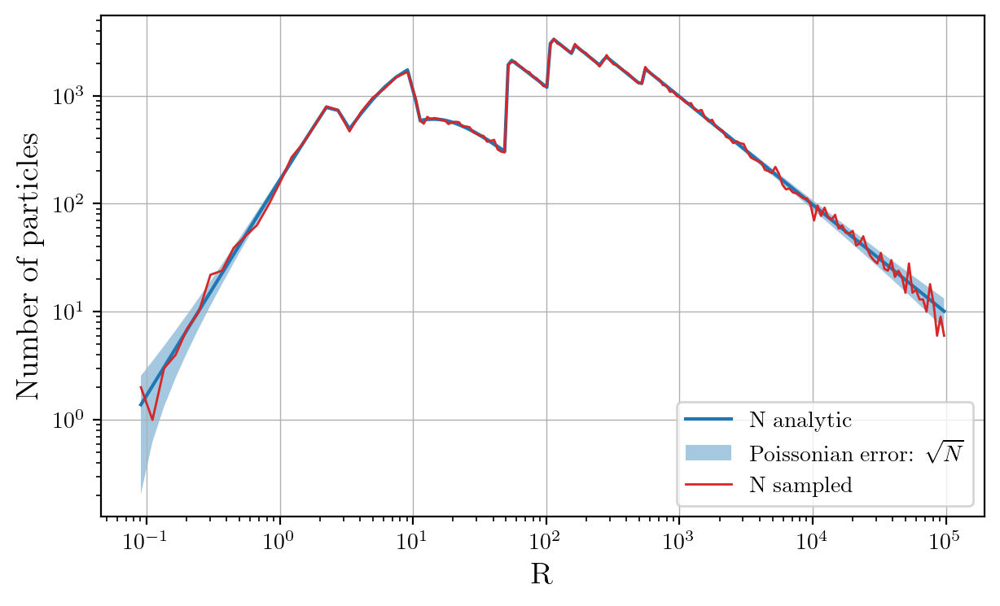

In [14]:
fig = plt.figure(figsize=(7,4))
ax = fig.add_subplot(111)
shell_r  = np.geomspace(R[2],a,50)[1::2]
shell_r = np.append(shell_r, np.geomspace(a+1,max(R),151))
shell_r_med = (shell_r[:-1]+shell_r[1:]) / 2
shell_M = np.array([np.sum(M[np.logical_and(R>shell_r[i],R<shell_r[i+1])]) for i in range(len(shell_r)-1)])
N_sampled = (np.array([len(R[np.logical_and(R>shell_r[i],R<shell_r[i+1])]) for i in range(len(shell_r)-1)]))
M_mean = shell_M/N_sampled

err_rad_N_analytic = (np.array([M_R(shell_r[i+1]) - M_R(shell_r[i])for i in range(len(shell_r)-1)])/M_mean)**(1/2)

N_samp = (np.array([len(R[np.logical_and(R>shell_r[i],R<shell_r[i+1])]) for i in range(len(shell_r)-1)]))
N_analytic = (np.array([M_R(shell_r[i+1]) - M_R(shell_r[i])for i in range(len(shell_r)-1)])/M_mean)

ax.plot(shell_r_med, N_analytic, label='N analytic', lw=1.5, ls='-')
ax.fill_between(shell_r_med, N_analytic - err_rad_N_analytic, N_analytic+err_rad_N_analytic, alpha=0.4, label=r'Poissonian error: $\sqrt{N}$')
ax.plot(shell_r_med, N_samp, label='N sampled', c='C3' , lw=1 , ls='-')

ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('R')
ax.set_ylabel('Number of particles')
#plt.savefig('N_particles.png', dpi=500)
plt.legend(loc='lower right')
plt.show()

/home/alice/.local/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/alice/.local/lib/python3.10/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_4518/344798738.py:30: RuntimeWarning: invalid value encountered in double_scalars
  shell_k = np.array([(np.mean(R[np.logical_and(R>shell_r[i],R<shell_r[i+1])]) * shell_der[i] + 4*np.mean(Theta_punto[np.logical_and(R>shell_r[i],R<shell_r[i+1])]**2))**(1/2)  for i in range(len(shell_r)-1)])


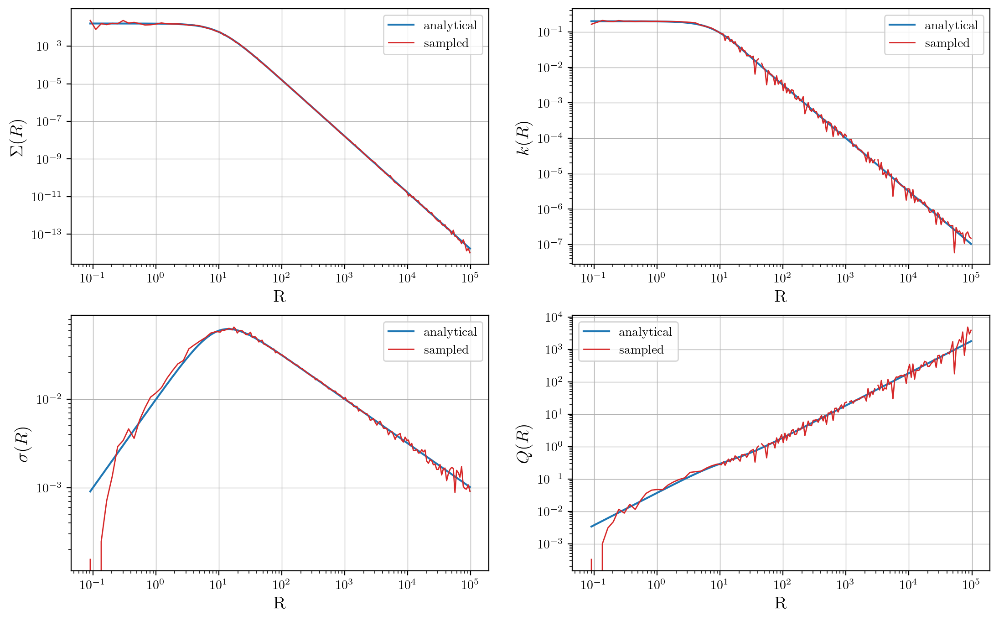

In [16]:
fig = plt.figure(figsize=(13,8))
ax = fig.add_subplot(221)

shell_r  = np.geomspace(R[2],a,50)[1::2]
shell_r = np.append(shell_r, np.geomspace(a+1,max(R),151))
shell_r_med = (shell_r[:-1]+shell_r[1:]) / 2
R_grid = np.geomspace(min(shell_r_med), max(shell_r_med), 10000)



shell_A = np.array([np.pi*shell_r[i+1]**2 - np.pi*shell_r[i]**2 for i in range(len(shell_r)-1)])
shell_M = np.array([np.sum(M[np.logical_and(R>shell_r[i],R<shell_r[i+1])]) for i in range(len(shell_r)-1)])
shell_Sigma = shell_M/shell_A
N_sampled = (np.array([len(R[np.logical_and(R>shell_r[i],R<shell_r[i+1])]) for i in range(len(shell_r)-1)]))
M_mean = shell_M/N_sampled

ax.loglog(R_grid, Sigma_R(R_grid), label='analytical', ls='-')
ax.loglog(shell_r_med,shell_Sigma, c='C3', lw=1, label='sampled')
ax.legend()
ax.set_ylabel('$\Sigma(R)$')
ax.set_xlabel('R')

ax = fig.add_subplot(222)

Theta_punto_ext = np.array([np.mean(Theta_punto[find_nearest(R,shell_r[i+1])-50:find_nearest(R,shell_r[i+1])+50]**2) for i in range(len(shell_r)-1)])
Theta_punto_int = np.array([np.mean(Theta_punto[find_nearest(R,shell_r[i])-50:find_nearest(R,shell_r[i])+50]**2) for i in range(len(shell_r)-1)])
Theta_punto_ext[:20] = np.array([Theta_punto[find_nearest(R,shell_r[i])] for i in range(20)])
Theta_punto_int[:20] = np.array([Theta_punto[find_nearest(R,shell_r[i])] for i in range(20)])
shell_der = np.array([(Theta_punto_ext[i] - Theta_punto_int[i]) / (shell_r[i+1]-shell_r[i]) for i in range(len(shell_r)-1)])   
shell_k = np.array([(np.mean(R[np.logical_and(R>shell_r[i],R<shell_r[i+1])]) * shell_der[i] + 4*np.mean(Theta_punto[np.logical_and(R>shell_r[i],R<shell_r[i+1])]**2))**(1/2)  for i in range(len(shell_r)-1)])

ax.loglog(R_grid, k_R(R_grid), label='analytical', ls='-')
ax.loglog(shell_r_med,shell_k, c='C3', lw=1, alpha=1, label='sampled')
ax.legend()
ax.set_ylabel('$k(R)$')
ax.set_xlabel('R')

ax = fig.add_subplot(223)

shell_sigma = np.array([np.std(V[np.logical_and(R>shell_r[i],R<shell_r[i+1])]) for i in range(len(shell_r)-1)])

ax.loglog(R_grid, sigma_R(R_grid), label='analytical', ls='-')
ax.loglog(shell_r_med,shell_sigma, c='C3', lw=1, alpha=1, label='sampled')
ax.legend()
ax.set_ylabel('$\sigma(R)$')
ax.set_xlabel('R')

ax = fig.add_subplot(224)

shell_Q = shell_k*shell_sigma / (3.36*shell_Sigma)

ax.loglog(R_grid, Q_R(R_grid), label='analytical', ls='-')
ax.loglog(shell_r_med,shell_Q, c='C3', lw=1, alpha=1, label='sampled')
ax.legend()
ax.set_ylabel('$Q(R)$')
ax.set_xlabel('R')

#plt.savefig('agreement.png', dpi=200)
plt.show()

## Write the initial parameters for the tree code

In [80]:
#n=1  # -> N=1.23e5 , Tstop=5000, dt=1, theta=0.5, eps=0.1, dtout=10 N_shell=[3000,30000,30000,30000,10000, 20000]
#n=2  # -> N=1.20e5 , Tstop=5000, dt=1, theta=0.5, eps=0.1, dtout=10 N_shell=[20000,20000,20000,20000,20000, 20000]
n=3 # -> N=1.02e5 , Tstop=5000, dt=1, theta=0.5, eps=0.1, dtout=10 N_shell=[3000,20000,20000,20000,20000, 20000,30000]
np.savetxt('masses'+str(n)+'.txt', M)
np.savetxt('positions'+str(n)+'.txt',np.column_stack((X,Y,Z)))
np.savetxt('velocities'+str(n)+'.txt', np.column_stack((v_x,v_y,v_z)))

with open('initial_data'+str(n)+'.txt', 'w+') as file:
    file.write(repr(N)+'\n3\n0\n')
    file.write(open('masses'+str(n)+'.txt','r').read()+open('positions'+str(n)+'.txt','r').read()+open('velocities'+str(n)+'.txt','r').read())

In [81]:
%%time
n=3

open('output'+str(n)+'.txt', 'w').close()
tstop = 5000
dtime = 1
theta = 0.5
eps = 0.1
dtout = 10
command = '../code/treecode in=initial_data' + str(n) + '.txt tstop=' + str(tstop) + ' theta='+ str(theta) +' eps='+str(eps) + ' dtime='+ str(dtime) + ' dtout=' + str(dtout) + ' out=output' +str(n)+ '.txt > logoutput' +str(n)+ '.txt'
print(command)
os.system(command)

../code/treecode in=initial_data3.txt tstop=5000 theta=0.5 eps=0.1 dtime=1 dtout=10 out=output3.txt > logoutput3.txt
CPU times: user 88.6 ms, sys: 60 ms, total: 149 ms
Wall time: 51min 50s


0

## Result of the simulation

In [13]:
n=3
data = pd.read_csv('output'+str(n)+'.txt', names = list(range(3)), sep = '\s+')

In [14]:
x,y,z,r,time = dati(data,N)

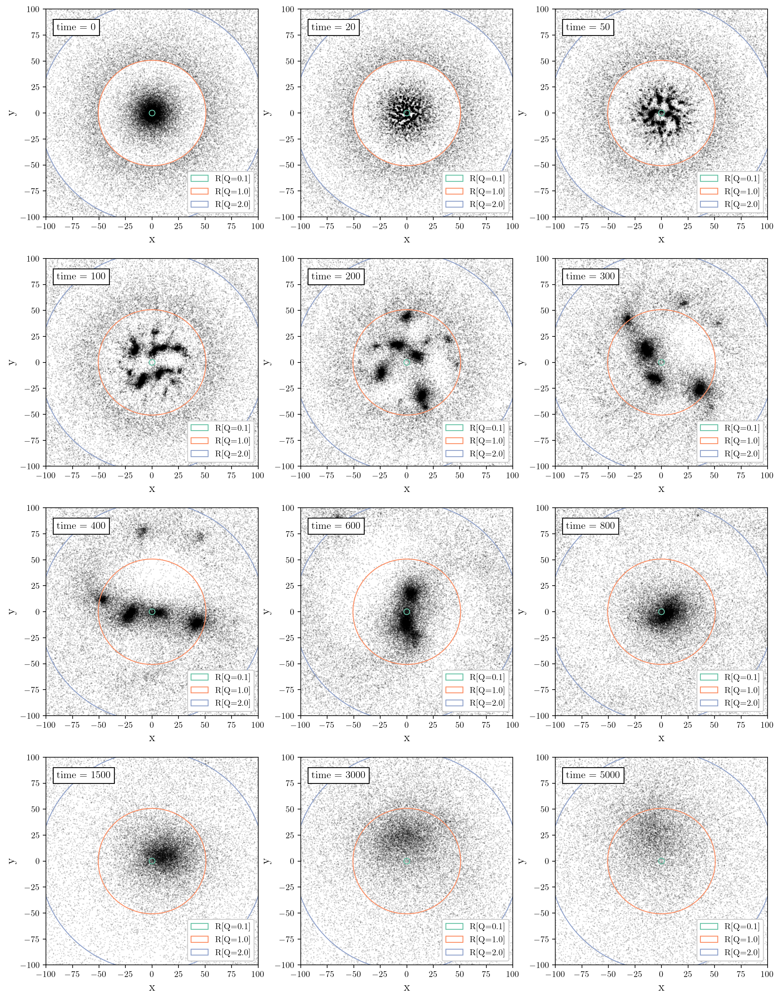

In [17]:
fig = plt.figure(figsize = (15,20))
idx_t = [0,1,5,10,20,30,50,70,90]
idx_t = [0,2,5,10,20,30,40,60,80,150,300,500]
snaps=len(idx_t)
#idx_t = (np.geomspace(0,15, snaps)).astype(int)
#idx_t = (np.linspace(0,len(time)-1, snaps)).astype(int)

for i in range(snaps):
    ax = fig.add_subplot(4,3,i+1)
    ax.scatter(x[:,idx_t[i]], y[:,idx_t[i]], color='k', s=0.1, alpha=0.2)
    for q,c in zip(Q_val[:3],col[:3]):
        circle_Q = plt.Circle((0, 0, 0), R[find_nearest(Q,q)], color=c, fill=False, label='R[Q=%.1f]'%q)
        ax.add_patch(circle_Q)
    ax.set_xlabel('x')
    ax.set_ylabel('y')
    ax.set_xlim(-100,100)
    ax.set_ylim(-100,100)
    ax.text(0.05, 0.9, 'time = %i'%time[idx_t[i]], transform=ax.transAxes, fontsize=12, bbox=dict(facecolor='white'))
    ax.grid()
    ax.legend(framealpha=1, loc='lower right')
plt.savefig('frames1.jpg',dpi=300)
plt.show()

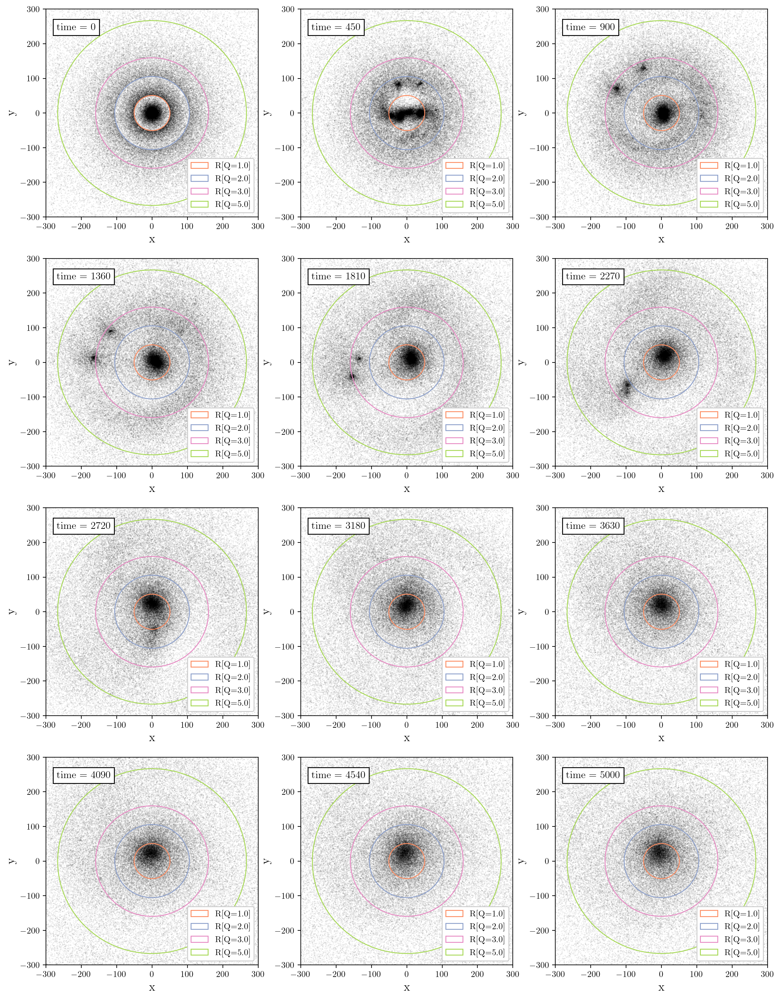

In [18]:
fig = plt.figure(figsize = (15,20))
idx_t = (np.linspace(0,len(time)-1, 12)).astype(int)
snaps=len(idx_t)
#idx_t = (np.geomspace(0,15, snaps)).astype(int)

for i in range(snaps):
    ax = fig.add_subplot(4,3,i+1)
    ax.scatter(x[:,idx_t[i]], y[:,idx_t[i]], color='k', s=0.02, alpha=0.2)
    for q,c in zip(Q_val[1:-1],col[1:-1]):
        circle_Q = plt.Circle((0, 0, 0), R[find_nearest(Q,q)], color=c, fill=False, label='R[Q=%.1f]'%q)
        ax.add_patch(circle_Q)
    ax.set_xlabel('x')
    ax.set_ylabel('y')
    ax.set_xlim(-300,300)
    ax.set_ylim(-300,300)
    ax.text(0.05, 0.9, 'time = %i'%time[idx_t[i]], transform=ax.transAxes, fontsize=12, bbox=dict(facecolor='white'))
    ax.grid()
    ax.legend(framealpha=1, loc='lower right')
plt.savefig('frames2.jpg',dpi=300)
plt.show()

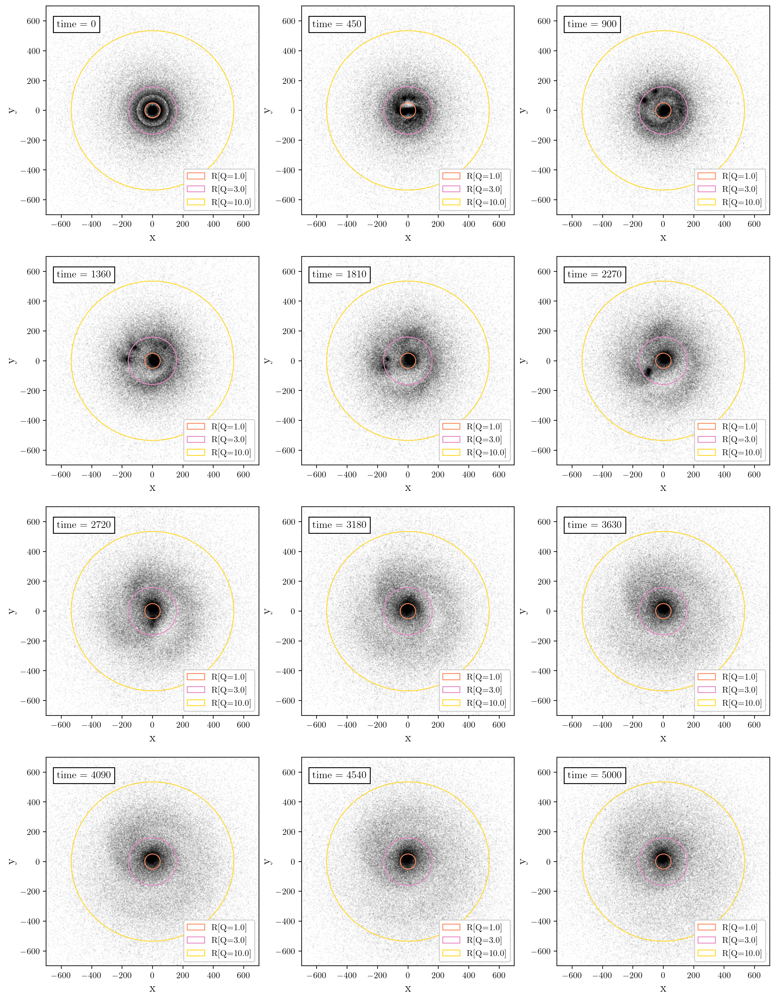

In [19]:
fig = plt.figure(figsize = (15,20))
idx_t = (np.linspace(0,len(time)-1, 12)).astype(int)
snaps=len(idx_t)
#idx_t = (np.geomspace(0,15, snaps)).astype(int)

for i in range(snaps):
    ax = fig.add_subplot(4,3,i+1)
    ax.scatter(x[:,idx_t[i]], y[:,idx_t[i]], color='k', s=0.008, alpha=0.2)
    for q,c in zip(Q_val[1::2],col[1::2]):
        circle_Q = plt.Circle((0, 0, 0), R[find_nearest(Q,q)], color=c, fill=False, label='R[Q=%.1f]'%q)
        ax.add_patch(circle_Q)
    ax.set_xlabel('x')
    ax.set_ylabel('y')
    ax.set_xlim(-700,700)
    ax.set_ylim(-700,700)
    ax.text(0.05, 0.9, 'time = %i'%time[idx_t[i]], transform=ax.transAxes, fontsize=12, bbox=dict(facecolor='white'))
    ax.grid()
    ax.legend(framealpha=1, loc='lower right')
plt.savefig('frames3.jpg',dpi=300)
plt.show()